In [2]:
%%HTML
<script src="require.js"></script>

In [3]:
from IPython.display import HTML, display, display_html

HTML("""<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

HTML('''<script src="https://cdnjs.cloudflare.com/ajax/libs/jquery/2.0.3/jquery.min.js "></script><script>
code_show=true; 
function code_toggle() {
if (code_show){
$('div.jp-CodeCell > div.jp-Cell-inputWrapper').hide();
} else {
$('div.jp-CodeCell > div.jp-Cell-inputWrapper').show();
}
code_show = !code_show
} 
$( document ).ready(code_toggle);</script><form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>
''')

In [1]:
#!pip install transformers
import os

os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'

# Local only (change to Jojie directory if needed)
os.environ['XDG_CACHE_HOME'] = '/home/msds2023/calbao/.cache'
os.environ['HUGGINGFACE_HUB_CACHE'] = '/home/msds2023/calbao/.cache'

In [2]:
import torch

# Set device to GPU if available, otherwise use CPU
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Running on device: {}'.format(device))

Running on device: cpu


In [3]:
import numpy as np
import io
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import seaborn as sns
from tqdm.notebook import tqdm

from moviepy.editor import VideoFileClip, ImageSequenceClip

import torch
from facenet_pytorch import (MTCNN)

from transformers import (AutoFeatureExtractor,
                          AutoModelForImageClassification,
                          AutoConfig)
                             
from PIL import Image, ImageDraw

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import skimage.io as sio
import numpy as np
from moviepy.editor import VideoFileClip, ImageSequenceClip
import glob
from amber import *

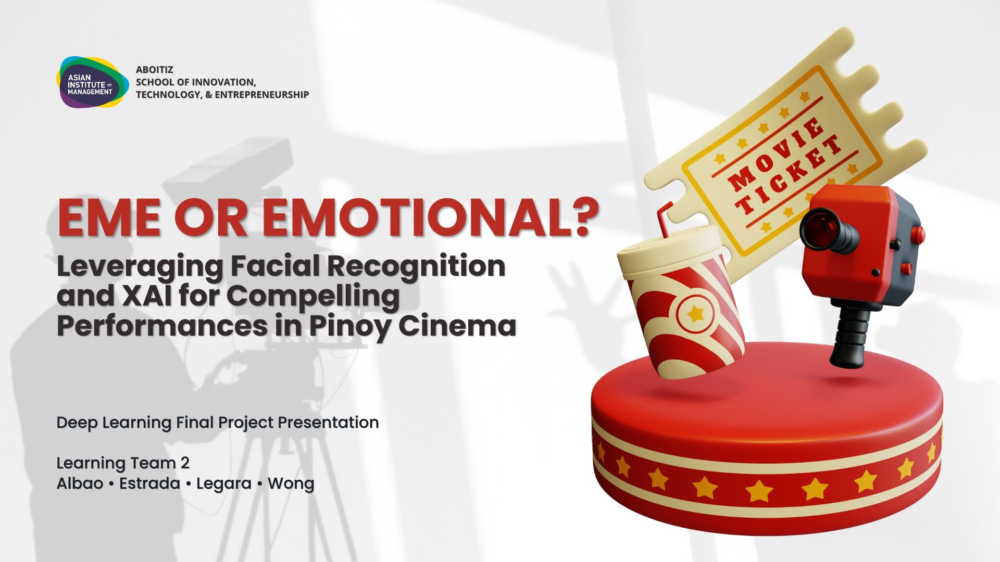

<h2 style="color: #B82E24"><b>Introduction</b></h2>

<p style='text-align:justify'>
In recent years, the rapid progress of artificial intelligence (AI) has significantly impacted various sectors of society. While its presence in industries like healthcare, finance, and transportation is widely recognized, the potential of AI in the arts, particularly in cinema, is yet to be fully explored.
</p>

<p style='text-align:justify'>
Facial expressions, dubbed as the universal language of emotion, play a pivotal role in storytelling, especially in cinema. The subtleties of an actor's performance, expressed through their countenance, can breathe life into a character, tug at audience's heartstrings, and etch memorable moments in the collective psyche.
</p>

<p style='text-align:justify'>
Taking us back to the era of silent films, one cannot help but marvel at the depth of emotion conveyed solely through facial expressions. A notable example is the classic "The Gold Rush", directed by Charlie Chaplin. This masterpiece showcases the effectiveness of facial expressions in narrating a compelling story, demonstrating a facet of cinema that resonates profoundly even in the absence of dialogue.
</p>

<p style='text-align:justify'>
The nuances of facial expressions in conveying emotions is crucial in contemporary cinema as well. In this study titled "Eme or Emotional? Leveraging Facial Recognition and Explainable AI for Compelling Performances in Pinoy Cinema", we explore the role of AI in dissecting and enhancing the quality of such performances. Through a combination of Facial Recognition and Explainable AI, we aim to provide a unique lens to examine and learn from the rich tapestry of emotions in Pinoy cinema.
</p>

<h2 style="color: #B82E24"><b>Motivation</b></h2>

<p style='text-align:justify'>
The motivation for our study stems from the obstacles aspiring actors encounter in their pursuit of proficiency. Expert coaching, often seen as a cornerstone of skill development, is not universally accessible. Furthermore, the evaluation of performances is subjective and can vary significantly, leading to inconsistent feedback and potential confusion for actors.
</p>

<p style='text-align:justify'>
Self-directed learners may opt to study great performances for inspiration, but the enormous volume of potential resources makes this task overwhelming. Therefore, the acting community needs an accessible, objective, and efficient evaluation method that can be used as a universal learning tool.
</p>

<p style='text-align:justify'>
Our study seeks to address these challenges by leveraging Facial Recognition and Explainable AI. This combination aims to standardize evaluations, democratize access to quality coaching resources, and make the process of learning from extensive film performances more practical.
</p>

<h2 style="color: #B82E24"><b>Problem Statement</b></h2>

<p style='text-align:justify'>
This research aims to address the problem: <b>"How can artificial intelligence and explainability techniques be utilized to offer objective and measurable insights to budding actors, thereby enhancing the quality of their craft in the Philippine cinema industry?"</b> This endeavor aims to formulate a solution that will serve as a guide for aspiring actors in their professional development.
</p>

<h2 style="color: #B82E24"><b>Data Source</b></h2>

<p style='text-align:justify'>
For the purposes of this study, we sought to analyze a diverse range of emotions as depicted in Philippine cinema. In order to achieve this, we chose to focus on critically acclaimed films from a variety of genres, including drama, romance, and horror. These films were selected not only for their quality and recognition, but also for their display of a wide array of emotions. In particular, the research makes use of video clips extracted from four notable Filipino films:
    <ol>
        <li>Four Sisters and a Wedding (2013)</li>
        <li>That Thing Called Tadhana (2014)</li>
        <li>Himala (1982)</li>
        <li>Feng Shui (2004)</li>
    </ol>
        These clips serve as rich sources of diverse and expressive human emotions, providing real-world data for our emotion recognition model. These films were sourced through YouTube. The movies were downloaded using a tool known as SaveFrom.net, which allows for the efficient downloading of video content from platforms like YouTube. In order to zero in on the most emotive and memorable scenes from these movies, we specifically sought out clips associated with notable quotes, as these are often the moments that best encapsulate the film's emotional spectrum.
</p>

<p style='text-align:justify'>
To train the explainer model, a custom dataset was compiled through a Google Images scraping procedure. The code for interacting with this API is documented in <b>supp-scrape-dataset.ipynb</b>. This dataset captures the full gamut of human emotions, classified into seven key categories: angry, disgust, fear, happy, neutral, sad, and surprise. This dataset was then split into train, validation, and test sets in <b>supp-split-dataset.ipynb</b> as preparation for training the explainer model. The decision to custom-build this dataset stems from the need to have a robust representation of emotions, crucial for the effective functioning of our model. 
</p>

<h2 style="color: #B82E24"><b>Methodology</b></h2>

<p style='text-align:justify'>
The methodology employed in this study comprises a three-stage pipeline leveraging state-of-the-art pre-trained models, each serving a specific function in our automated content analysis system.
</p>

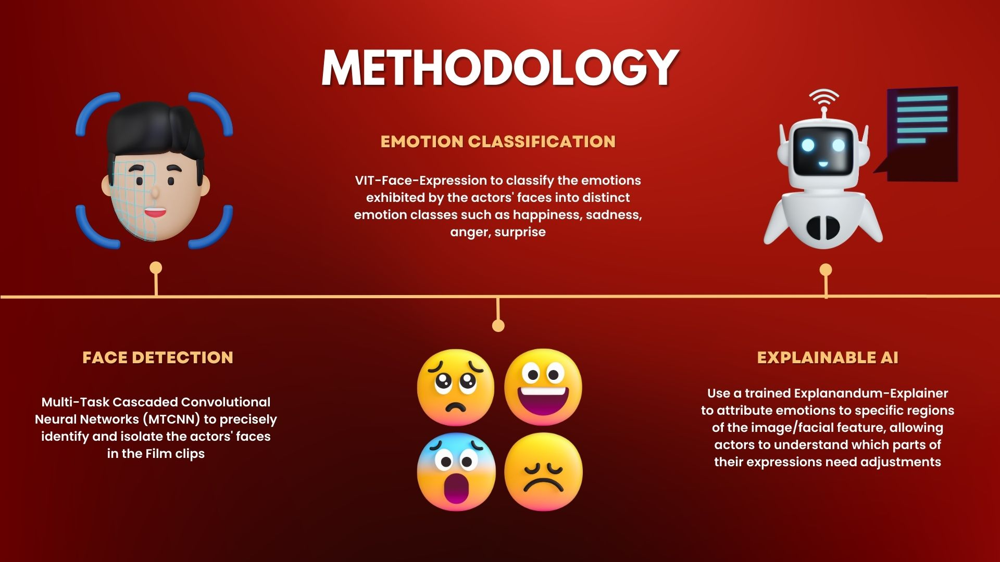

<p style='text-align:center'><b>Figure 1.</b> Methodology</p>

<p style='text-align:justify'>
Our methodology provides a systematic approach to objectively analyze acting performances, using a combination of advanced AI techniques. This pipeline allows us to dissect acting performances with precision and offer measurable insights, thus democratizing access to high-quality acting resources and enhancing the potential of Philippine cinema.
</p>


<h3 style="color: #B82E24"><b>Face Detection</b></h3>

<p style='text-align:justify'>The first stage of our pipeline is face detection in film clips, for which we leverage the Multi-Task Cascaded Convolutional Networks (MTCNN) <a href='#transfer'>[1]</a>. MTCNN is an efficient deep learning model designed for face detection and alignment, using a three-stage cascading process to generate and refine candidate facial windows, and subsequently identify facial features accurately. It was introduced by Zhang, et al. in the 2016 IEEE Signal Processing Letters conference <a href='#mtcnn'>[2]</a>.
</p>

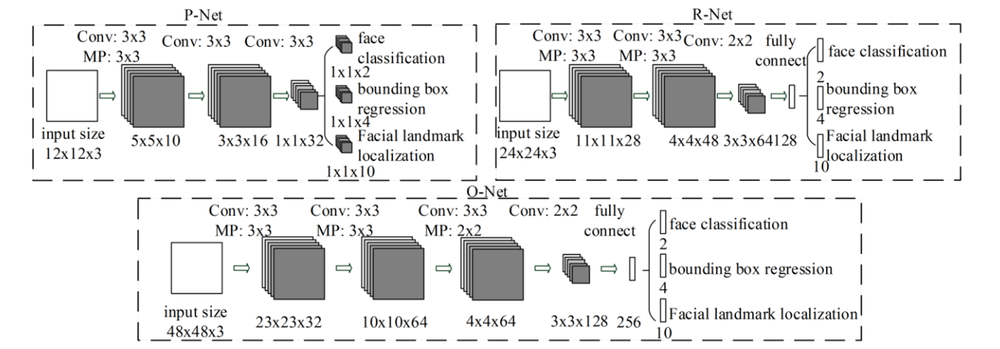

<p style='text-align:center'><b>Figure 2.</b> Multi-Task Cascaded Convolutional Networks (MTCNN) Architecture</p>

In [7]:
# Initialize MTCNN model for single face cropping
mtcnn = MTCNN(
    image_size=160,
    margin=0,
    min_face_size=200,
    thresholds=[0.6, 0.7, 0.7],
    factor=0.709,
    post_process=True,
    keep_all=False,
    device=device
)
    
# Load the pre-trained model and feature extractor
extractor = AutoFeatureExtractor.from_pretrained(
    "trpakov/vit-face-expression"
)
model = AutoModelForImageClassification.from_pretrained(
    "trpakov/vit-face-expression"
)

2023-06-14 16:34:40.284248: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


<h3 style="color: #B82E24"><b>Emotion Recognition</b></h3>

<p style='text-align:justify'>The second stage involves emotion recognition where we employ the ViT-Face-Expression model. The Vision Transformer (ViT), a game-changer in visual data analysis, adopts the Transformer architecture used in natural language processing for images, treating them as sequences of patches. By leveraging self-attention mechanisms, VIT captures local and global patterns, allowing it to match or even exceed traditional Convolutional Neural Network (CNN) models in certain computer vision tasks. Dosovitskiy, et al. presented this paper on ViT during the 2022 Conference on Neural Information Processing Systems <a href='#vit'>[3]</a>.
</p>

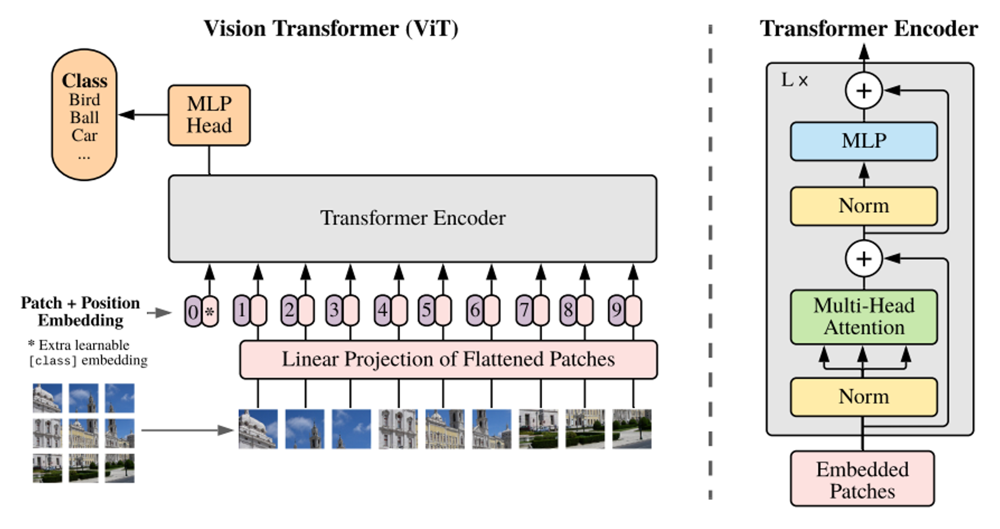

<p style='text-align:center'><b>Figure 3.</b> Vision Transformer (ViT) Architecture</p>

In [50]:
def detect_emotions_single(image, vid_img, clr):
    """
    Detect emotions from a given image, displays the detected face and the
    emotion probabilities in a bar plot.

    Parameters
    ----------
        image (PIL.Image): The input image.

    Returns
    -------
        PIL.Image: The cropped face from the input image.
    """
    
    # Create a copy of the image to draw on
    temporary = image.copy()

    # Use the MTCNN model to detect faces in the image
    sample = mtcnn.detect(temporary)

    # If a face is detected
    if sample[0] is not None:
        
        # Get the bounding box coordinates of the face
        box = sample[0][0]
        
        # Crop the detected face from the image
        face = temporary.crop(box)

        # Pre-process the cropped face to be fed into the emotion detection model
        inputs = extractor(images=face, return_tensors="pt")

        # Pass the pre-processed face through the model to get emotion predictions
        outputs = model(**inputs)

        # Apply softmax to the logits to get probabilities
        probabilities = torch.nn.functional.softmax(outputs.logits, dim=-1)

        # Retrieve the id2label attribute from the configuration
        id2label = AutoConfig.from_pretrained(
            "trpakov/vit-face-expression"
        ).id2label

        # Convert probabilities tensor to a Python list
        probabilities = probabilities.detach().numpy().tolist()[0]

        # Map class labels to their probabilities
        class_probabilities = {id2label[i]: prob for i,
                               prob in enumerate(probabilities)}

        # Prepare a figure with 2 subplots: one for the face image, one for the bar plot
        
        import pandas as pd
        df_plot = pd.DataFrame({i:[j] for i, j in class_probabilities.items()})
        
        # radar
        categories = [i.upper() for i in df_plot.columns]
        categories = [*categories, categories[0]]
        
        figm = px.imshow(vid_img)
        
        fig = make_subplots(
                            rows=2, cols=1, vertical_spacing=0.08,
                            specs=[[{"type": "image"}], [{"type": "scatterpolar"}]])
        fig.add_trace(figm.data[0], 1, 1)

        r_ = df_plot.iloc[0].values.tolist()
        r_ = [*r_, r_[0]]
        fig.add_trace(go.Scatterpolar(
            r=r_,
            theta=categories,
            fill='toself',
            #name=str(df_plot.index[cluster-1]),
            line_color=clr,
            opacity=0.7),2,1)

        fig.update_layout(template=None, plot_bgcolor="#FFFFFF",
                          paper_bgcolor="#FFFFFF",#width=1000,
                          height=1000,
                          polar=dict(radialaxis=dict(angle=90,
                                                     tick0=1,
                                                     dtick=0.5,
                                                     range=[-0.4, 1],
                                                     tickangle=90,
                                                     titlefont={"size": 15, }),
                                     angularaxis=dict(rotation=90,
                                                      tickfont={"size": 15})),
                          showlegend=False)
        fig.update_layout(xaxis1_visible=False, yaxis1_visible=False)
        fig.show(config={
            "editable": True,
            'toImageButtonOptions': {
                'format': 'png',  # one of png, svg, jpeg, webp
                'filename': 'ml3_fp',
                'scale': 5  # Multiply title/legend/axis/canvas sizes by this factor
            }
        })

In [ ]:
frame = video_data[350]

# Convert the frame to a PIL image and display it
image = Image.fromarray(frame)

detect_emotions_single(image, video_data[350], '#B82E24')

In [52]:
def detect_emotions(image, vid_img):
    """
    Detect emotions from a given image.
    Returns a tuple of the cropped face image and a
    dictionary of class probabilities.
    """
    temporary = image.copy()

    # Detect faces in the image using the MTCNN group model
    sample = mtcnn.detect(temporary)
    if sample[0] is not None:
        box = sample[0][0]

        # Crop the face
        face = temporary.crop(box)

        # Pre-process the face
        inputs = extractor(images=face, return_tensors="pt")

        # Run the image through the model
        outputs = model(**inputs)

        # Apply softmax to the logits to get probabilities
        probabilities = torch.nn.functional.softmax(outputs.logits, dim=-1)

        # Retrieve the id2label attribute from the configuration
        config = AutoConfig.from_pretrained("trpakov/vit-face-expression")
        id2label = config.id2label

        # Convert probabilities tensor to a Python list
        probabilities = probabilities.detach().numpy().tolist()[0]

        # Map class labels to their probabilities
        class_probabilities = {
            id2label[i]: prob for i, prob in enumerate(probabilities)
        }

        return vid_img, class_probabilities
    return None, None

In [59]:
def plotly_fig2array(fig):
    #convert Plotly fig to  an array
    fig_bytes = fig.to_image(format="png", scale=1)
    buf = io.BytesIO(fig_bytes)
    img = Image.open(buf)
    return np.asarray(img)

def create_combined_image(face, vid_img, class_probabilities, clr):
    """
    Create an image combining the detected face and a barplot
    of the emotion probabilities.

    Parameters:
    face (PIL.Image): The detected face.
    class_probabilities (dict): The probabilities of each
        emotion class.

    Returns:
    np.array: The combined image as a numpy array.
    """
    # Prepare a figure with 2 subplots: one for the face image, one for the bar plot
        
    import pandas as pd
    df_plot = pd.DataFrame({i:[j] for i, j in class_probabilities.items()})

    # radar
    categories = [i.upper() for i in df_plot.columns]
    categories = [*categories, categories[0]]

    figm = px.imshow(vid_img)

    fig = make_subplots(
                        rows=2, cols=1, vertical_spacing=0.08,
                        specs=[[{"type": "image"}], [{"type": "scatterpolar"}]])
    fig.add_trace(figm.data[0], 1, 1)

    r_ = df_plot.iloc[0].values.tolist()
    r_ = [*r_, r_[0]]
    fig.add_trace(go.Scatterpolar(
        r=r_,
        theta=categories,
        fill='toself',
        #name=str(df_plot.index[cluster-1]),
        line_color=clr,
        opacity=0.7),2,1)

    fig.update_layout(template=None, plot_bgcolor="#FFFFFF",
                      paper_bgcolor="#FFFFFF",#width=1000,
                      height=1000,
                      polar=dict(radialaxis=dict(angle=90,
                                                 tick0=1,
                                                 dtick=0.5,
                                                 range=[-0.4, 1],
                                                 tickangle=90,
                                                 titlefont={"size": 15, }),
                                 angularaxis=dict(rotation=90,
                                                  tickfont={"size": 15})),
                      showlegend=False)
    fig.update_layout(xaxis1_visible=False, yaxis1_visible=False)
    # Convert the figure to a numpy array
    img = plotly_fig2array(fig)
    return img

<h3 style="color: #B82E24"><b>Explainable AI</b></h3>

<p style='text-align:justify'>The final stage of our pipeline involves explainability. To interpret the decision-making process of our VIT model, we use an Explanandum-Explainer framework. The Explainer model generates class-specific attribution masks, pinpointing the regions of the actor's face that VIT pays attention to when classifying emotions. These explainability techniques give us a deeper understanding of the AI's behavior and provide insight into which facial features significantly convey different emotions. The reference algorithm and architecture was developed by Stalder, et al. and was presented in the 2022 Conference on Neural Information Processing Systems <a href='#explainer'>[4]</a>. We adapted their algorithm found on <a href='https://github.com/stevenstalder/NN-Explainer'>Github</a> to our specific needs for the research.
</p>

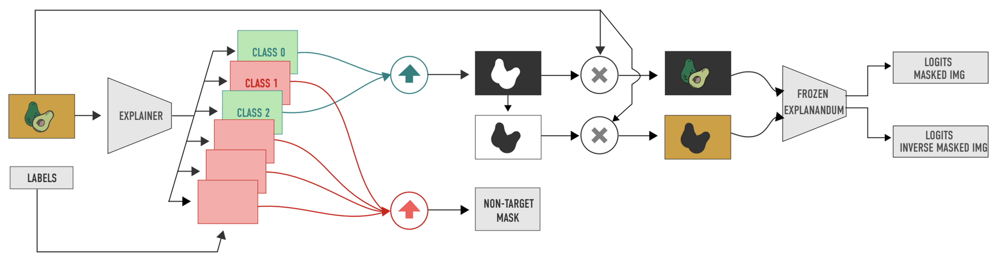

<p style='text-align:center'><b>Figure 4.</b> Explanandum-Explainer Architecture</p>

<h2 style="color: #B82E24"><b>Results and Discussion</b></h2>

<p style='text-align:justify'>
In this section, we present the findings and insights derived from our study on emotion recognition in select movie scenes and the attributions resulting from our explainable AI model. Through an in-depth analysis and interpretation of the collected data, we aim to unravel the impact of AI on the understanding and portrayal of emotions in Pinoy cinema, while also exploring the transparency and interpretability of our AI model. The following discussions provide a comprehensive analysis of the results obtained and the subsequent discussions that arise from them.
</p>

<h3 style="color: #B82E24"><b>Emotion Recognition</b></h3>

<p style='text-align:justify'>
Our analysis concentrated on a diverse selection of movie scenes sourced from various Pinoy films. To accurately determine the emotions portrayed by the actors, we employed sophisticated facial recognition algorithms, specifically MTCNN and VIT-Face-Expression. MTCNN aided in detecting faces, while VIT-Face-Expression facilitated the classification of the displayed emotions. The data we collected encompasses a broad range of emotional states, such as happiness, sadness, anger, fear, and disgust.

Now, let's delve into each of the emotions depicted in the chosen movie scenes individually.
</p>

<h4 style="color: #B82E24"><b>Four Sisters and a Wedding</b></h4>

In [60]:
# Load your video
four_sisters_video = 'videos/four_sisters.mp4'
clip = VideoFileClip(four_sisters_video)

vid_fps = clip.fps
print(f"Video fps: {vid_fps}")

# Get the video (as frames)
video = clip.without_audio()
video_data = np.array(list(video.iter_frames()))

Video fps: 23.976023976023978


In [61]:
skips = 1
reduced_video = []

for i in tqdm(range(0, len(video_data), skips)):
    reduced_video.append(video_data[i])

  0%|          | 0/384 [00:00<?, ?it/s]

In [62]:
# Define a list of emotions
emotions = ["angry", "disgust", "fear", "happy", "neutral", "sad", "surprise"]

# List to hold the combined images
combined_images = []

# Create a list to hold the class probabilities for all frames
all_class_probabilities = []

# Loop over video frames
for i, frame in tqdm(enumerate(reduced_video),
                     total=len(reduced_video),
                     desc="Processing frames"):
    # Convert frame to uint8
    frame = frame.astype(np.uint8)

    # Call detect_emotions to get face and class probabilities
    face, class_probabilities = detect_emotions(Image.fromarray(frame), frame)
    
    # If a face was found
    if face is not None:
        # Create combined image for this frame
        combined_image = create_combined_image(face, frame, class_probabilities, '#ffbd59')
        
        # Append combined image to the list
        combined_images.append(combined_image)
    else:
        # If no face was found, set class probabilities to None
        class_probabilities = {emotion: None for emotion in emotions}
        
    # Append class probabilities to the list
    all_class_probabilities.append(class_probabilities)

Processing frames:   0%|          | 0/384 [00:00<?, ?it/s]

In [63]:
# Convert list of images to video clip
clip_with_plot = ImageSequenceClip(combined_images,
                                   fps=vid_fps/skips)  # Choose the frame rate (fps) according to your requirement
 
# Display the clip
clip_with_plot.ipython_display(width=900)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


<p style='text-align:center'><b>Figure 5.</b> Radar Plot of Frame-by-Frame Emotions (Four Sisters and a Wedding)</p>

<p style='text-align:justify'>
    <b>Four Sisters and a Wedding</b> is a captivating film that delves into the intricate emotional dynamics within the Salazar family. It masterfully portrays a wide array of emotions, including joy, love, jealousy, regret, and reconciliation, resulting in a deeply resonant cinematic experience. One particularly memorable and "memeable" scene in the movie involves the revelation that Teddie has not found success in her life abroad. This scene effectively conveys a spectrum of emotions.
</p>

<p style='text-align:justify'>
As the secret is unveiled, Teddie experiences a combination of fear and sadness, anxiously anticipating her mother's reaction. Her emotions are palpable as she navigates the uncertainty of how her revelation will be received. Simultaneously, Bobbie, upon witnessing Teddie's confession of jealousy, displays a mixture of confusion, with facial expressions blending elements of happiness, anger, and sadness. This emotionally charged scene highlights the complexity and depth of the characters' feelings, leaving a lasting impact on the viewers.
</p>

In [64]:
clip_with_plot.write_videofile("videos/v_emotion_foursisters.mp4")

Moviepy - Building video v_emotion_foursisters.mp4.
Moviepy - Writing video v_emotion_foursisters.mp4



Moviepy - Done !
Moviepy - video ready v_emotion_foursisters.mp4


<h4 style="color: #B82E24"><b>That Thing Called Tadhana</b></h4>

In [65]:
# Load your video
tadhana_video = 'videos/tadhana.mp4'
clip = VideoFileClip(tadhana_video)

vid_fps = clip.fps
print(f"Video fps: {vid_fps}")

# Get the video (as frames)
video = clip.without_audio()
video_data = np.array(list(video.iter_frames()))

skips = 1
reduced_video = []

for i in tqdm(range(0, len(video_data), skips)):
    reduced_video.append(video_data[i])

Video fps: 30.0


  0%|          | 0/471 [00:00<?, ?it/s]

In [66]:
# Define a list of emotions
emotions = ["angry", "disgust", "fear", "happy", "neutral", "sad", "surprise"]

# List to hold the combined images
combined_images = []

# Create a list to hold the class probabilities for all frames
all_class_probabilities = []

# Loop over video frames
for i, frame in tqdm(enumerate(reduced_video),
                     total=len(reduced_video),
                     desc="Processing frames"):
    # Convert frame to uint8
    frame = frame.astype(np.uint8)

    # Call detect_emotions to get face and class probabilities
    face, class_probabilities = detect_emotions(Image.fromarray(frame), frame)
    
    # If a face was found
    if face is not None:
        # Create combined image for this frame
        combined_image = create_combined_image(face, frame, class_probabilities, '#B82E24')
        
        # Append combined image to the list
        combined_images.append(combined_image)
    else:
        # If no face was found, set class probabilities to None
        class_probabilities = {emotion: None for emotion in emotions}
        
    # Append class probabilities to the list
    all_class_probabilities.append(class_probabilities)

Processing frames:   0%|          | 0/471 [00:00<?, ?it/s]

In [67]:
from moviepy.editor import VideoFileClip, ImageSequenceClip
# Convert list of images to video clip
clip_with_plot = ImageSequenceClip(combined_images,
                                   fps=vid_fps/skips)  # Choose the frame rate (fps) according to your requirement
 
# Display the clip
clip_with_plot.ipython_display(width=900)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


<p style='text-align:center'><b>Figure 6.</b> Radar Plot of Frame-by-Frame Emotions (That Thing Called Tadhana)</p>

<p style='text-align:justify'>
    The film <b>That Thing Called Tadhana</b> has become synonymous with its ability to evoke deep emotions and resonate with viewers through its relatable "hugot feels." It follows the journey of two individuals who are grappling with heartbreak and embarking on a quest of self-discovery, exploring the intense emotions associated with love and breakups.
</p>

<p style='text-align:justify'>
In another iconic scene, the protagonists, Mace and Anthony, engage in a conversation about the expectations placed upon them during this phase of their lives. Mace, with a mixture of happiness and sadness apparent on her face, acknowledges the contrast between the facade of greatness they are expected to embody and their true emotional state. She raises a toast, saying, "To the great people that we are today," aware of the bittersweet reality they face. On the other hand, Anthony playfully responds with a smile on his face, saying "Sinungaling!", reflecting a sense of happiness and lightheartedness in their banter.
</p>

<p style='text-align:justify'>
This particular scene captures the nuanced emotions experienced by the characters, juxtaposing the societal expectations they confront with the underlying truth of their personal struggles. The interplay of happiness, sadness, and playfulness adds depth to their interaction and contributes to the film's poignant exploration of love and self-acceptance.
</p>

In [68]:
clip_with_plot.write_videofile("videos/v_emotion_tadhana.mp4")

Moviepy - Building video v_emotion_tadhana.mp4.
Moviepy - Writing video v_emotion_tadhana.mp4



Moviepy - Done !
Moviepy - video ready v_emotion_tadhana.mp4


<h4 style="color: #B82E24"><b>Feng Shui</b></h4>

In [69]:
# Load your video
fengshui_video = 'videos/feng_shui.mp4'
clip = VideoFileClip(fengshui_video)

vid_fps = clip.fps
print(f"Video fps: {vid_fps}")

# Get the video (as frames)
video = clip.without_audio()
video_data = np.array(list(video.iter_frames()))

skips = 1
reduced_video = []

for i in tqdm(range(0, len(video_data), skips)):
    reduced_video.append(video_data[i])

Video fps: 29.97002997002997


  0%|          | 0/518 [00:00<?, ?it/s]

In [70]:
# Define a list of emotions
emotions = ["angry", "disgust", "fear", "happy", "neutral", "sad", "surprise"]

# List to hold the combined images
combined_images = []

# Create a list to hold the class probabilities for all frames
all_class_probabilities = []

# Loop over video frames
for i, frame in tqdm(enumerate(reduced_video),
                     total=len(reduced_video),
                     desc="Processing frames"):
    # Convert frame to uint8
    frame = frame.astype(np.uint8)

    # Call detect_emotions to get face and class probabilities
    face, class_probabilities = detect_emotions(Image.fromarray(frame), frame)
    
    # If a face was found
    if face is not None:
        # Create combined image for this frame
        combined_image = create_combined_image(face, frame, class_probabilities, '#312b2c')
        
        # Append combined image to the list
        combined_images.append(combined_image)
    else:
        # If no face was found, set class probabilities to None
        class_probabilities = {emotion: None for emotion in emotions}
        
    # Append class probabilities to the list
    all_class_probabilities.append(class_probabilities)

Processing frames:   0%|          | 0/518 [00:00<?, ?it/s]

In [71]:
from moviepy.editor import VideoFileClip, ImageSequenceClip
# Convert list of images to video clip
clip_with_plot = ImageSequenceClip(combined_images,
                                   fps=vid_fps/skips)  # Choose the frame rate (fps) according to your requirement
 
# Display the clip
clip_with_plot.ipython_display(width=900)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


<p style='text-align:center'><b>Figure 7.</b> Radar Plot of Frame-by-Frame Emotions (Feng Shui)</p>

<p style='text-align:justify'>
The 2004 movie <b>Feng Shui</b> stands as a remarkable cinematic achievement, captivating audiences with its compelling narrative and its profound ability to evoke deep emotions. Through its gripping storytelling, the film delves into the intricate realms of fate, superstition, and the enigmatic forces that intricately interweave with ordinary existence.
</p>

<p style='text-align:justify'>
Within one particular scene, we witness Joy's face filled with a potent mixture of fear and sadness as she comes to a startling realization: she is confronted with apparitions of Inton, Denton, Ingrid, and Thelma. The weight of this eerie encounter is palpable as Joy's emotions are laid bare, reflecting her genuine terror and the overwhelming sadness that accompanies the apparitions' presence.
</p>

<p style='text-align:justify'>
This pivotal scene epitomizes the film's ability to evoke intense emotions within its viewers. Joy's expression of fear and sadness serves as a conduit for the audience's own apprehension, drawing them further into the narrative's suspenseful depths. The scene encapsulates the haunting nature of the movie, leaving a lasting impact on the audience as they navigate the intricate web of destiny and the supernatural elements that define the story.
</p>

In [72]:
clip_with_plot.write_videofile("videos/v_emotion_fengshui.mp4")

Moviepy - Building video v_emotion_fengshui.mp4.
Moviepy - Writing video v_emotion_fengshui.mp4



Moviepy - Done !
Moviepy - video ready v_emotion_fengshui.mp4


<h4 style="color: #B82E24"><b>Himala</b></h4>

In [74]:
# Load your video
himala_video = 'videos/himala_.mp4'
clip = VideoFileClip(himala_video)

vid_fps = clip.fps
print(f"Video fps: {vid_fps}")

# Get the video (as frames)
video = clip.without_audio()
video_data = np.array(list(video.iter_frames()))

skips = 1
reduced_video = []

for i in tqdm(range(0, len(video_data), skips)):
    reduced_video.append(video_data[i])

Video fps: 30.0


  0%|          | 0/355 [00:00<?, ?it/s]

In [75]:
# Define a list of emotions
emotions = ["angry", "disgust", "fear", "happy", "neutral", "sad", "surprise"]

# List to hold the combined images
combined_images = []

# Create a list to hold the class probabilities for all frames
all_class_probabilities = []

# Loop over video frames
for i, frame in tqdm(enumerate(reduced_video),
                     total=len(reduced_video),
                     desc="Processing frames"):
    # Convert frame to uint8
    frame = frame.astype(np.uint8)

    # Call detect_emotions to get face and class probabilities
    face, class_probabilities = detect_emotions(Image.fromarray(frame), frame)
    
    # If a face was found
    if face is not None:
        # Create combined image for this frame
        combined_image = create_combined_image(face, frame, class_probabilities, '#5271ff')
        
        # Append combined image to the list
        combined_images.append(combined_image)
    else:
        # If no face was found, set class probabilities to None
        class_probabilities = {emotion: None for emotion in emotions}
        
    # Append class probabilities to the list
    all_class_probabilities.append(class_probabilities)

Processing frames:   0%|          | 0/355 [00:00<?, ?it/s]

In [76]:
from moviepy.editor import VideoFileClip, ImageSequenceClip
# Convert list of images to video clip
clip_with_plot = ImageSequenceClip(combined_images,
                                   fps=vid_fps/skips)  # Choose the frame rate (fps) according to your requirement
 
# Display the clip
clip_with_plot.ipython_display(width=900)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


<p style='text-align:center'><b>Figure 8.</b> Radar Plot of Frame-by-Frame Emotions (Himala)</p>

<p style='text-align:justify'>
<b>Himala</b> holds an esteemed position in the realm of Filipino cinema, recognized as one of its greatest contributions. The film delves profoundly into the intricate web of human emotions, specifically exploring the profound connection between faith and desperation.
</p>

<p style='text-align:justify'>
One particular scene from Himala has etched itself into the collective memory of viewers. As Elsa utters the iconic line, "Walang himala!", her face becomes a canvas displaying a range of powerful emotions. Sadness, anger, and disgust intertwine, etching their mark upon her countenance.
</p>

<p style='text-align:justify'>
Elsa's visage mirrors the depth of her emotions, encapsulating the weight of her struggles and disillusionment. The scene resonates with the audience, who are drawn into the vortex of conflicting feelings that Elsa experiences. It serves as a poignant reflection of the complexities of faith, the fragility of human spirit, and the disheartening realities that can test one's beliefs.
</p>

<p style='text-align:justify'>
This powerful scene exemplifies the film's ability to evoke profound emotions and provoke introspection. Through Elsa's expressions of sadness, anger, and disgust, Himala immerses viewers in the turbulent emotional journey of its characters and invites contemplation on the nature of faith and the harsh realities of life.
</p>

In [77]:
clip_with_plot.write_videofile("videos/v_emotion_himala.mp4")

Moviepy - Building video v_emotion_himala.mp4.
Moviepy - Writing video v_emotion_himala.mp4



Moviepy - Done !
Moviepy - video ready v_emotion_himala.mp4


<h3 style="color: #B82E24"><b>Explainable AI</b></h3>

<p style='text-align:justify'>
The transparency and interpretability of our AI model were pivotal in thoroughly analyzing the factors influencing its decision-making process. By utilizing explainable AI techniques, we aimed to identify the significant facial features and cues that drove the model's predictions. Through a comprehensive attribution analysis, we gained valuable insights into the relative significance of various facial regions and expressions in determining the recognized emotions.
</p>

<p style='text-align:justify'>
Now, let's delve into the attributed facial features for the diverse movie scenes we have previously explored.
</p>

In [9]:
data_module = CustomDataModule(
    'datasets/data/classifier/'
)

num_classes = 7

In [10]:
model = ExplainerClassifierModel(
    num_classes=num_classes,
    use_mask_variation_loss=False,
    use_mask_area_loss=True
)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
2023-06-14 17:48:08.525379: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
/home/msds2023/pestrada/.local/lib/python3.10/site-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: Th

In [11]:
log_dir = "tb_logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
logger = pl.loggers.TensorBoardLogger(log_dir, name="NN Explainer")

In [12]:
early_stop_callback = EarlyStopping(
    monitor="val_loss",
    min_delta=0.001,
    patience=5,
    verbose=False,
    mode="min",
)

In [13]:
trainer = pl.Trainer(
    logger=logger,
    callbacks=[early_stop_callback],
    max_epochs=300
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


In [14]:
train_model = True
data_module.setup('test')
if train_model:
    torch.autograd.set_detect_anomaly(True)
    trainer.fit(model=model, datamodule=data_module)
    trainer.test(dataloaders=data_module.test_dataloader())
else:
    trainer.test(model=model, datamodule=data_module)

Means:           [0.6235189 0.4881056 0.4277293]
Std. Deviations: [0.25944903 0.22985741 0.22180712]


Missing logger folder: tb_logs/fit/20230614-174812/NN Explainer


Means:           [0.6235189 0.4881056 0.4277293]
Std. Deviations: [0.25944903 0.22985741 0.22180712]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                            | Params
---------------------------------------------------------------------------
0 | explainer              | Deeplabv3Resnet50ExplainerModel | 39.6 M
1 | classifier             | ViTForImageClassification       | 85.8 M
2 | total_variation_conv   | TotalVariationConv              | 18    
3 | classification_loss_fn | CrossEntropyLoss                | 0     
4 | train_metrics          | SingleLabelMetrics              | 0     
5 | valid_metrics          | SingleLabelMetrics              | 0     
6 | test_metrics           | SingleLabelMetrics              | 0     
---------------------------------------------------------------------------
39.6 M    Trainable params
85.8 M    Non-trainable params
125 M     Total params
501.757   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/home/msds2023/pestrada/.local/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:280: PossibleUserWarning: The number of training batches (13) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/home/msds2023/pestrada/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/checkpoint_connector.py:148: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `.test(ckpt_path='best')` to use the best model or `.test(ckpt_path='last')` to use the last model. If you pass a value, this warning will be silenced.
  rank_zero_warn(
Restoring states from the checkpoint path at tb_logs/fit/20230614-174812/NN Explainer/version_0/checkpoints/epoch=85-step=1118.ckpt


Means:           [0.6235189 0.4881056 0.4277293]
Std. Deviations: [0.25944903 0.22985741 0.22180712]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from the checkpoint at tb_logs/fit/20230614-174812/NN Explainer/version_0/checkpoints/epoch=85-step=1118.ckpt


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│       test_Accuracy       │    0.9606626033782959     │
│       test_F-Score        │    0.9354895353317261     │
│      test_Precision       │    0.9629977345466614     │
│        test_Recall        │    0.9128401875495911     │
│         test_loss         │    0.6426100134849548     │
└───────────────────────────┴───────────────────────────┘

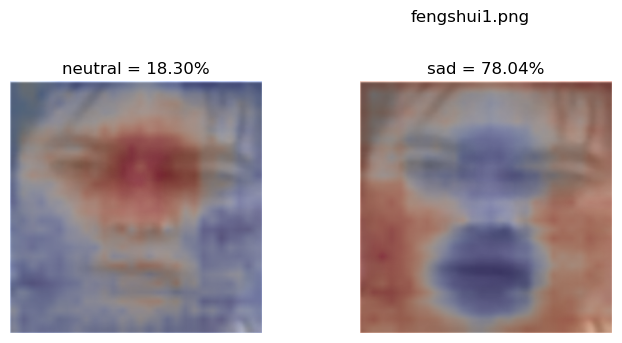

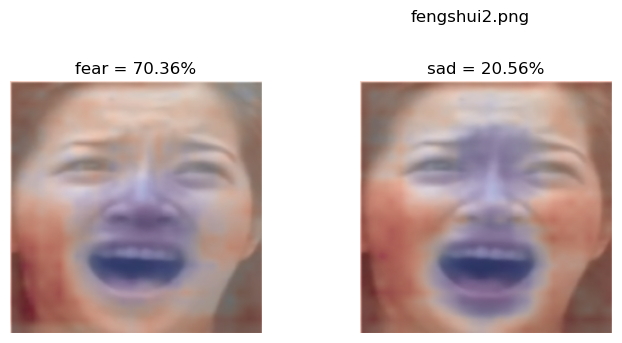

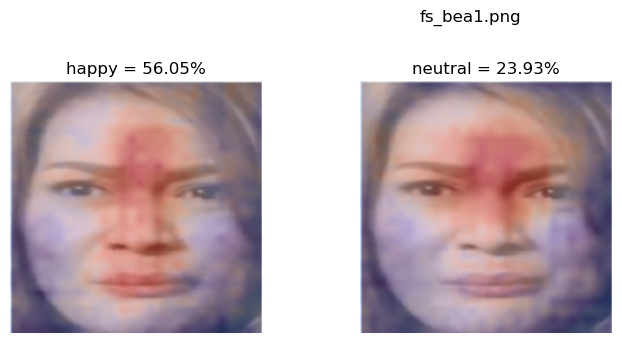

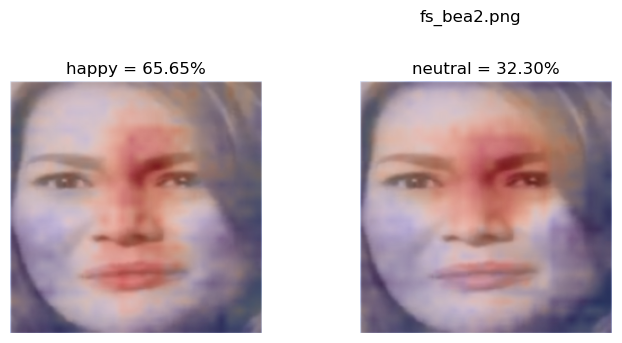

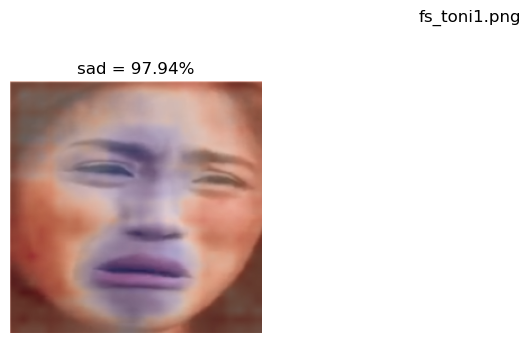

...

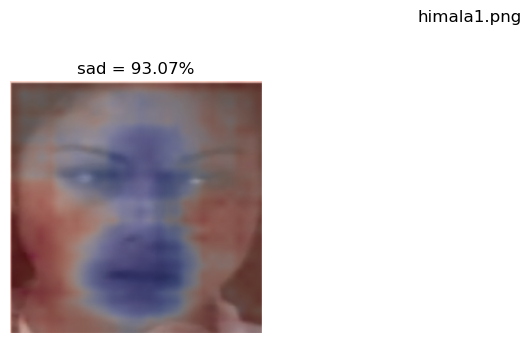

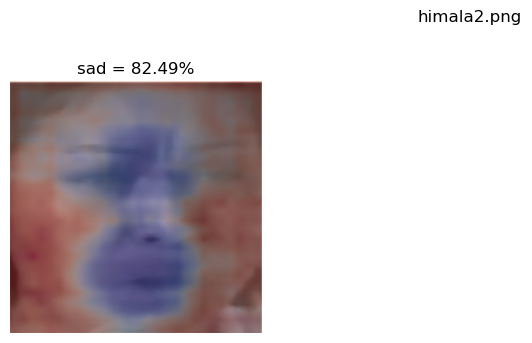

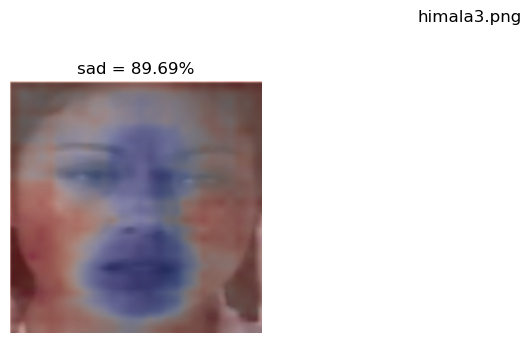

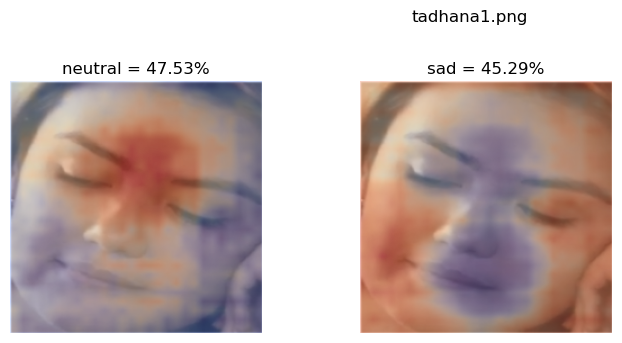

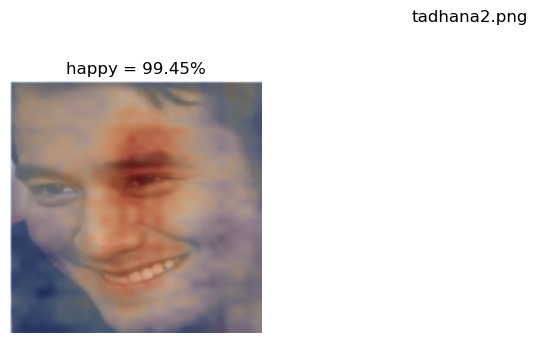

In [95]:
import glob
from PIL import Image

emo = {
    0: "angry",
    1: "disgust",
    2: "fear",
    3: "happy",
    4: "neutral",
    5: "sad",
    6: "surprise"
  }

for img_path in glob.glob('datasets/patticakes/*'):
    image = Image.open(img_path).convert('RGB')
    test_transforms = transforms.Compose([
                transforms.Resize(size=(224,224)),
                transforms.ToTensor()])

    image_tensor = test_transforms(image)
    labels = model.classifier(image_tensor.unsqueeze(0)).logits
    labels = F.softmax(labels, dim=1)
    targets = ((labels > (1/7))*1).nonzero()[:, -1].flatten().detach().numpy()
    fig, ax = plt.subplots(2, 3, figsize=(6.4*2, 4.8*1.5))
    
    fig.suptitle(f'{img_path.split("/")[-1]}')

    ax = ax.flatten()
    for i, (target, label) in enumerate(zip(targets, labels.flatten()[targets])):
        ax[i].imshow(image_tensor.squeeze().permute(1, 2, 0))
        ax[i].imshow(mask.squeeze()[target].sigmoid(), cmap='coolwarm',
                     alpha=0.4)
        ax[i].set_title(f'{emo[target]} = {label*100:.2f}%')
        ax[i].set_axis_off()
    for i in range(1, len(ax) - len(targets) + 1):
        fig.delaxes(ax[-i])
    plt.show()

<p style='text-align:center'><b>Figure 9.</b> Detected Emotion Probabilities with Region Attributions</p>

<p style='text-align:justify'>
Some notable attributions from these results are as follows.
    <ul>
        <li> In the film <b>Four Sisters and a Wedding</b>, Teddie's expression of fear and sadness creates a poignant and emotionally charged scene. Her face reveals a mixture of tension between the eyebrows and cheeks, representing fear, while the drooping or sagging of her cheeks signifies sadness. This combination of emotions reflects the impact of Teddie's revelation about her lack of success abroad and the anticipation of her mother's reaction. 
        <li> In <b>That Thing Called Tadhana,</b>, Mace's neutral expression between the brows and the presence of sadness in her cheeks indicate a complex emotional state, reflecting her inner conflict. Conversely, Anthony's happiness is depicted through changes in his eyes, the ridge between his eyes, and his joyful smile. These emotions contribute to the film's exploration of love, heartbreak, and self-discovery. 
        <li> In <b>Feng Shui</b>, Joy's expression of fear aligns with the tension between her eyebrows and cheeks, while the apparitions' neutral and sad emotions add an eerie and unsettling element to the scene. These emotions heighten the supernatural encounters and the emotional impact on Joy's character. 
        <li> In <b>Himala</b>, Elsa's display of anger, sadness, and disgust is represented through distinct facial cues. Her lips exhibit signs of anger, her cheeks convey sadness, and her upper face reflects disgust. These emotions delve into the internal struggles and disillusionment Elsa experiences, exploring the complexities of faith and human emotions.
    </ul>
</p>

<p style='text-align:justify'>
These emotions serve as powerful tools to engage the audience, highlighting the characters' internal struggles, conflicts, and journeys. Through the nuanced portrayal of these emotions, the films evoke a range of responses from viewers, immersing them in the emotional landscapes and thematic explorations of love, family, faith, and self-discovery. The combination of these emotions with the storytelling elements creates a captivating cinematic experience, leaving a lasting impact on the audience long after the credits roll.
</p>

<h2 style="color: #B82E24"><b>Conclusion</b></h2>

<p style='text-align:justify'>
Our study demonstrates the significant potential of AI and explainability techniques in the development of budding actors in the Philippine cinema industry. The results highlight the importance of emotional complexity in scenes, which were found to be more engaging. By dissecting memorable scenes from renowned Filipino films, we offer objective and measurable insights to enhance acting craft.
</p>

<p style='text-align:justify'>
The use of pretrained models streamlined our process and enhanced accuracy, demonstrating the effectiveness of such models in addressing the challenges of data scarcity, limited processing power, and time constraints. These models can be fine-tuned to specific tasks, offering a practical solution for efficient and large-scale emotion analysis in films.
</p>

<p style='text-align:justify'>
For novice actors pursuing self-study, our research provides a valuable tool to help navigate through vast resources and extract key insights. In addition to providing a supplementary resource to traditional coaching, our project democratizes access to high-quality training resources and bridges the disparity gap in the industry.
</p>

<p style='text-align:justify'>
Overall, by leveraging AI and explainability methods, we pave the way for a more standardized, objective, and accessible training process in the Philippine cinema industry, contributing to its overall growth and quality enhancement.
</p>

<h2 style="color: #B82E24"><b>Recommendations</b></h2>

<p style='text-align:justify'>
This study is just a stepping stone towards the utilization of AI in improving acting performances and offers several avenues for future research:<br>
<ol>
<li><b>Expanding Analysis:</b> Emotion in movies is layered and transcends beyond facial expressions. Future studies could consider the role of elements such as music score, script delivery, and even contextual elements like setting and plot in emotional conveyance.</li>
<li><b>Real-time Application:</b> While our project focused on pre-recorded movies, another potential application could be in real-time acting. Novices could act in front of a camera, and the AI model could provide immediate feedback, enhancing the learning process.</li>
<li><b>Cultural Nuances:</b> If the goal is to aid local artists in joining the global arena, it would be beneficial to explore the nuances in how different cultures express similar emotions. Future research could involve internationally acclaimed films, understanding diverse emotional expression, and adapting them to improve local performances.</li>
<li><b>Emotional Progression Analysis:</b> In addition to frame-by-frame analysis, understanding emotional progression throughout a scene or a movie could add significant value. By examining notable emotional progressions in a similar way to chord progressions in music, a more comprehensive understanding of effective acting can be achieved.</li>
</ol>
By considering these recommendations, future research can further enhance the quality of acting in Philippine cinema and bring it to new heights on the global stage.
</p>

<h2 style="color: #B82E24"><b>References</b></h2>

<a id='transfer'></a>
[1] Chobanyan, M. (2019). Training an emotion detector with transfer learning. towardsdatascience. [URL](https://towardsdatascience.com/training-an-emotion-detector-with-transfer-learning-91dea84adeed).

<a id='mtcnn'></a>
[2] Zhang, K., Zhang, Z., Li, Z., & Qiao, Y. (2016). Joint face detection and alignment using multitask cascaded convolutional networks. IEEE signal processing letters, 23(10), 1499-1503. [URL](https://arxiv.org/ftp/arxiv/papers/1604/1604.02878.pdf).

<a id='vit'></a>
[3] Dosovitskiy, A., Beyer, L., Kolesnikov, A., Weissenborn, D., Zhai, X., Unterthiner, T., ... & Houlsby, N. (2020). An image is worth 16x16 words: Transformers for image recognition at scale. 2022 Conference on neural information processing systems. [URL](https://arxiv.org/pdf/2010.11929.pdf).

<a id='explainer'></a>
[4] Stalder, S., Perraudin, N., Achanta, R., Perez-Cruz, F., & Volpi, M. (2022). What You See is What You Classify: Black Box Attributions. 2022 Conference on Neural Information Processing Systems. [URL](https://proceedings.neurips.cc/paper_files/paper/2022/file/0073cc73e1873b35345209b50a3dab66-Paper-Conference.pdf).